Copyright 2020 DeepMind Technologies Limited

Licensed under the Apache License, Version 2.0 (the "License");
you may not use this file except in compliance with the License.
You may obtain a copy of the License at

     https://www.apache.org/licenses/LICENSE-2.0

Unless required by applicable law or agreed to in writing, software
distributed under the License is distributed on an "AS IS" BASIS,
WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
See the License for the specific language governing permissions and
limitations under the License.

## Clone repo and import dependencies

In [1]:
# !pip install tensorflow==1.15 dm-sonnet==1.36 tensor2tensor==1.14

import os
import numpy as np
import tensorflow.compat.v1 as tf
tf.logging.set_verbosity(tf.logging.ERROR)  # Hide TF deprecation messages
import matplotlib.pyplot as plt

# %cd /tmp
# %rm -rf /tmp/deepmind_research
# !git clone https://github.com/deepmind/deepmind-research.git \
#   /tmp/deepmind_research
# %cd /tmp/deepmind_research/polygen
import modules
import data_utils

## Prepare a synthetic dataset
We prepare a dataset of meshes using four simple geometric primitives.

The important function here is `data_utils.load_process_mesh`, which loads the raw `.obj` file, normalizes and centers the meshes, and applies quantization to the vertex positions. The mesh faces are flattened and treated as a long sequence, with a new-face token (`=1`) separating the faces. For each of the four synthetic meshes, we associate a unique class label, so we can train class-conditional models.

After processing the raw mesh data into numpy arrays, we create a `tf.data.Dataset` that we can use to feed data to our models. 

In [10]:
# Prepare synthetic dataset
ex_list = []
for k, mesh in enumerate(['cube', 'cylinder', 'cone', 'icosphere']):
    vertices, faces = data_utils.read_obj(os.path.join('meshes', '{}.obj'.format(mesh)))
    vertices = mesh.vertices[:, [2, 0, 1]]
    vertices = data_utils.center_vertices(vertices)
    vertices = data_utils.normalize_vertices_scale(vertices)

    print(faces)
    break
  # mesh_dict = data_utils.load_process_mesh(
  #     os.path.join('meshes', '{}.obj'.format(mesh)))
  # mesh_dict['class_label'] = k
  # ex_list.append(mesh_dict)
# ex_list
# synthetic_dataset = tf.data.Dataset.from_generator(
#     lambda: ex_list,
#     output_types={
#         'vertices': tf.int32, 'faces': tf.int32, 'class_label': tf.int32},
#     output_shapes={
#         'vertices': tf.TensorShape([None, 3]), 'faces': tf.TensorShape([None]),
#         'class_label': tf.TensorShape(())}
#     )
# ex = synthetic_dataset.make_one_shot_iterator().get_next()
#
# # Inspect the first mesh
# with tf.Session() as sess:
#   ex_np = sess.run(ex)
# print(ex_np)
#
# # Plot the meshes
# mesh_list = []
# with tf.Session() as sess:
#   for i in range(4):
#     ex_np = sess.run(ex)
#     mesh_list.append(
#         {'vertices': data_utils.dequantize_verts(ex_np['vertices']),
#          'faces': data_utils.unflatten_faces(ex_np['faces'])})
# data_utils.plot_meshes(mesh_list, ax_lims=0.4)

[[0, 1, 2, 3], [3, 2, 4, 5], [5, 4, 6, 7], [7, 6, 1, 0], [3, 5, 7, 0], [4, 2, 1, 6]]


In [6]:
# ex_list[0]

## Vertex model

#### Prepare the dataset for vertex model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a vertex model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 



In [7]:
# Prepare the dataset for vertex model training
vertex_model_dataset = data_utils.make_vertex_model_dataset(
    synthetic_dataset, apply_random_shift=False)
vertex_model_dataset = vertex_model_dataset.repeat()
vertex_model_dataset = vertex_model_dataset.padded_batch(
    4, padded_shapes=vertex_model_dataset.output_shapes)
vertex_model_dataset = vertex_model_dataset.prefetch(1)
vertex_model_batch = vertex_model_dataset.make_one_shot_iterator().get_next()

# Create vertex model
vertex_model = modules.VertexModel(
    decoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    class_conditional=True,
    num_classes=4,
    max_num_input_verts=250,
    quantization_bits=8,
)
vertex_model_pred_dist = vertex_model(vertex_model_batch)
vertex_model_loss = -tf.reduce_sum(
    vertex_model_pred_dist.log_prob(vertex_model_batch['vertices_flat']) * 
    vertex_model_batch['vertices_flat_mask'])
vertex_samples = vertex_model.sample(
    4, context=vertex_model_batch, max_sample_length=200, top_p=0.95,
    recenter_verts=False, only_return_complete=False)

print(vertex_model_batch)
print(vertex_model_pred_dist)
print(vertex_samples)

{'vertices': <tf.Tensor 'IteratorGetNext_4:2' shape=(?, ?, 3) dtype=int32>, 'faces': <tf.Tensor 'IteratorGetNext_4:1' shape=(?, ?) dtype=int32>, 'class_label': <tf.Tensor 'IteratorGetNext_4:0' shape=(?,) dtype=int32>, 'vertices_flat': <tf.Tensor 'IteratorGetNext_4:3' shape=(?, ?) dtype=int32>, 'vertices_flat_mask': <tf.Tensor 'IteratorGetNext_4:4' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("vertex_model_1_2_vertex_model_1_create_dist_Categorical", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'completed': <tf.Tensor 'Any_1:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_9:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv_1:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_5:0' shape=(?, 200) dtype=float32>}


## Face model

#### Prepare the dataset for face model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a face model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 

In [8]:
face_model_dataset = data_utils.make_face_model_dataset(
    synthetic_dataset, apply_random_shift=False)
face_model_dataset = face_model_dataset.repeat()
face_model_dataset = face_model_dataset.padded_batch(
    4, padded_shapes=face_model_dataset.output_shapes)
face_model_dataset = face_model_dataset.prefetch(1)
face_model_batch = face_model_dataset.make_one_shot_iterator().get_next()

# Create face model
face_model = modules.FaceModel(
    encoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    decoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    class_conditional=False,
    max_seq_length=500,
    quantization_bits=8,
    decoder_cross_attention=True,
    use_discrete_vertex_embeddings=True,
)
face_model_pred_dist = face_model(face_model_batch)
face_model_loss = -tf.reduce_sum(
    face_model_pred_dist.log_prob(face_model_batch['faces']) * 
    face_model_batch['faces_mask'])
face_samples = face_model.sample(
    context=vertex_samples, max_sample_length=500, top_p=0.95,
    only_return_complete=False)
print(face_model_batch)
print(face_model_pred_dist)
print(face_samples)

{'vertices': <tf.Tensor 'IteratorGetNext_5:4' shape=(?, ?, 3) dtype=float32>, 'faces': <tf.Tensor 'IteratorGetNext_5:1' shape=(?, ?) dtype=int64>, 'class_label': <tf.Tensor 'IteratorGetNext_5:0' shape=(?,) dtype=int32>, 'num_vertices': <tf.Tensor 'IteratorGetNext_5:3' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'IteratorGetNext_5:5' shape=(?, ?) dtype=float32>, 'faces_mask': <tf.Tensor 'IteratorGetNext_5:2' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("face_model_1_face_model_create_dist_Categorical", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'context': {'completed': <tf.Tensor 'Any_1:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_9:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv_1:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_5:0' shape=(?, 200) dtype=float32>}, 'completed': <tf.Tensor 'Any_2:0' shape=(?,) dtype=bool>, 'faces': <tf.Tensor 'Pad_2:0' shape=(?, ?) dtype=int32>, 'num_face_indices': <tf.Tensor

## Train on the synthetic data

Now that we've created vertex and face models and their respective data loaders, we can train them and look at some outputs. While we train the models together here, they can be trained seperately and recombined later if required. 

Step 0
Loss (vertices) 2469.339111328125
Loss (faces) 2799.291015625


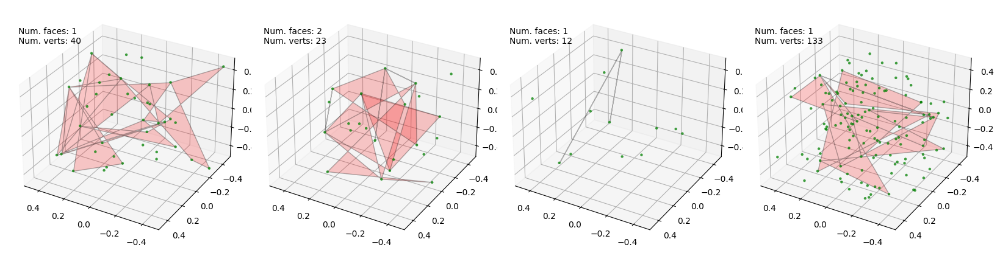

Step 5
Loss (vertices) 2361.89111328125
Loss (faces) 2657.1689453125


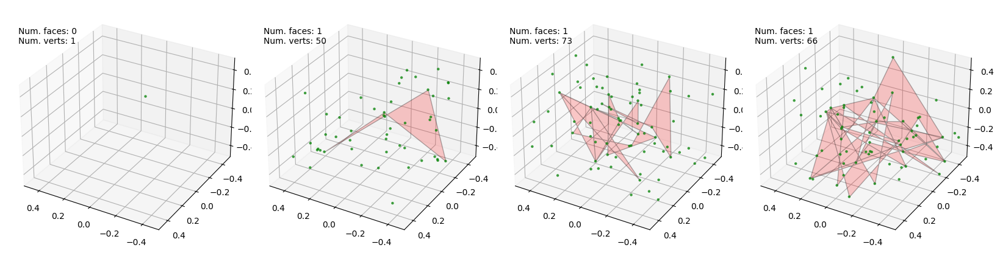

Step 10
Loss (vertices) 2224.073486328125
Loss (faces) 2483.6162109375


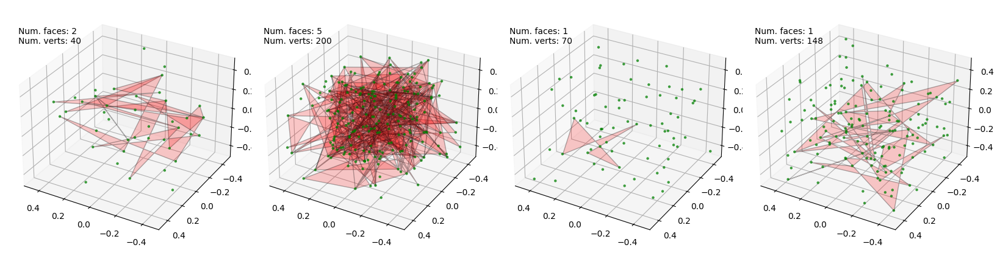

Step 15
Loss (vertices) 2024.6162109375
Loss (faces) 2395.2587890625


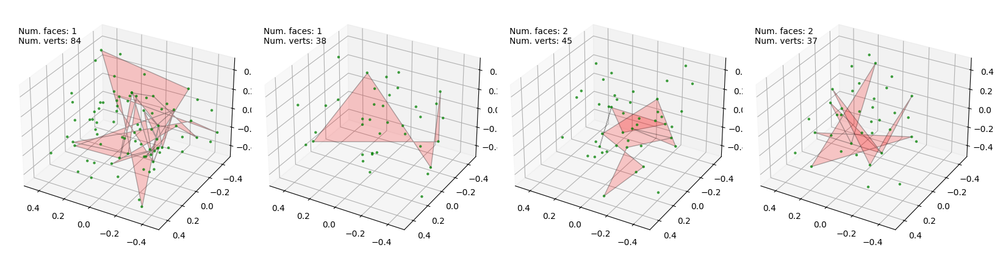

Step 20
Loss (vertices) 1789.766357421875
Loss (faces) 2285.198974609375


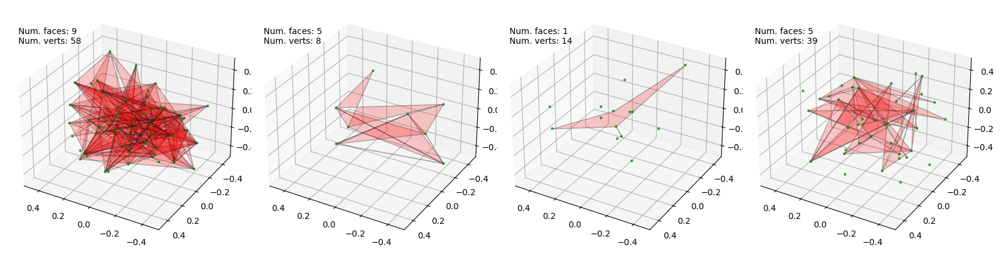

Step 25
Loss (vertices) 1622.547607421875
Loss (faces) 2198.4169921875


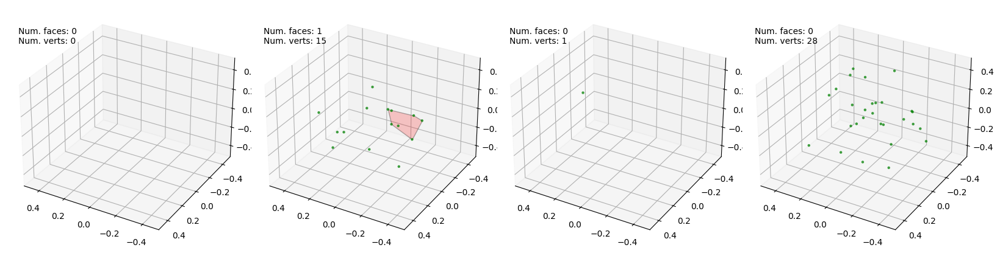

Step 30
Loss (vertices) 1519.6881103515625
Loss (faces) 2080.801025390625


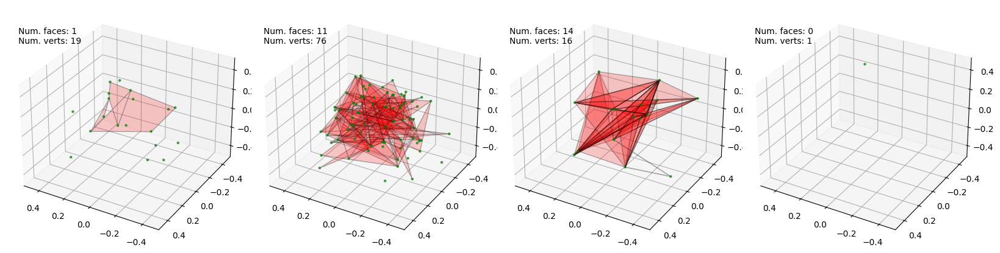

Step 35
Loss (vertices) 1444.9989013671875
Loss (faces) 1942.182373046875


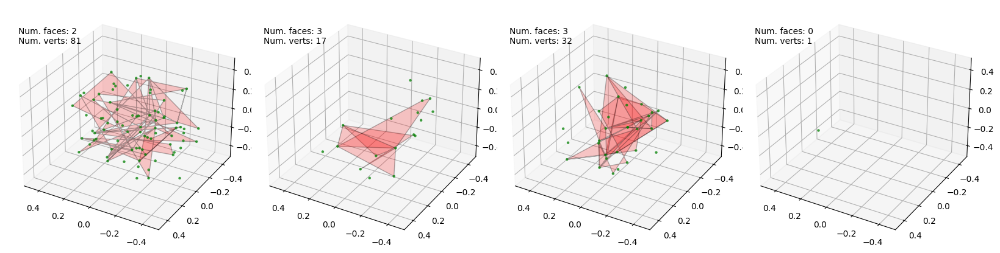

Step 40
Loss (vertices) 1373.8759765625
Loss (faces) 1795.64697265625


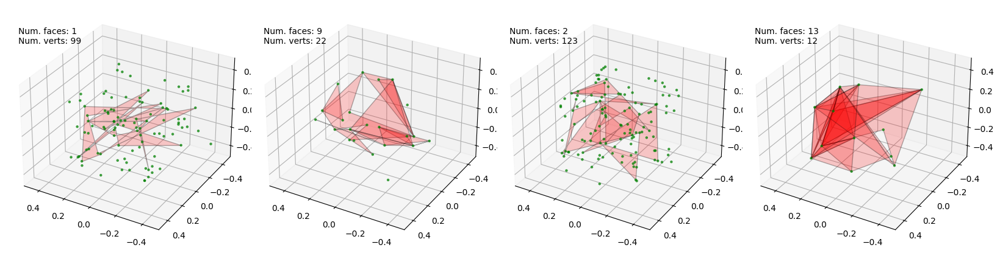

Step 45
Loss (vertices) 1292.9854736328125
Loss (faces) 1657.93994140625


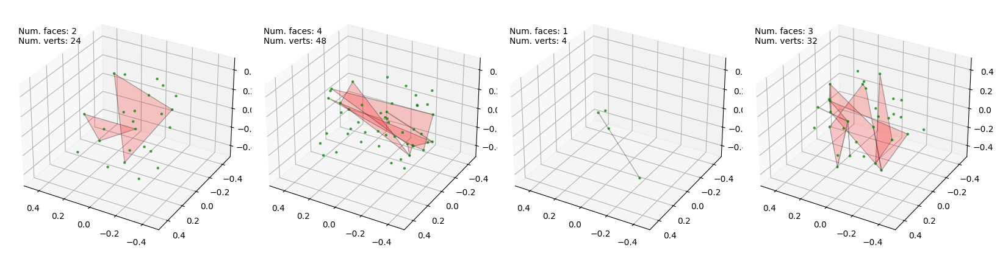

Step 50
Loss (vertices) 1219.99072265625
Loss (faces) 1510.2755126953125


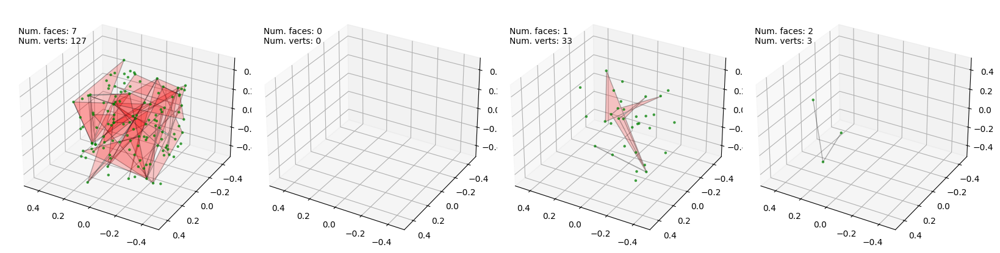

Step 55
Loss (vertices) 1131.8486328125
Loss (faces) 1352.01171875


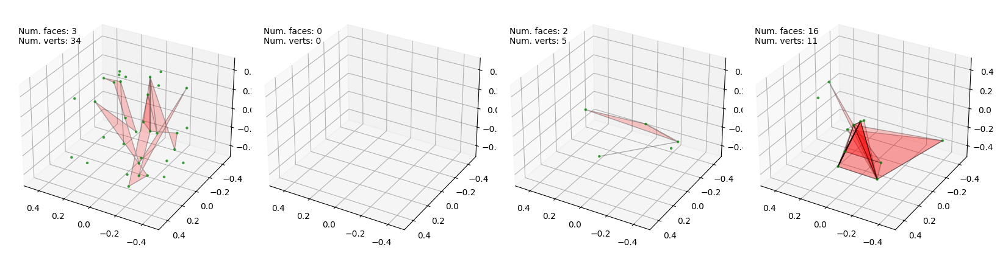

Step 60
Loss (vertices) 1043.281494140625
Loss (faces) 1209.439697265625


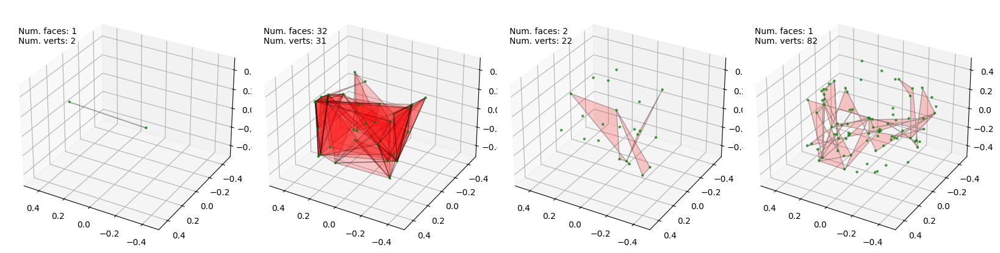

Step 65
Loss (vertices) 958.5693969726562
Loss (faces) 1084.2830810546875


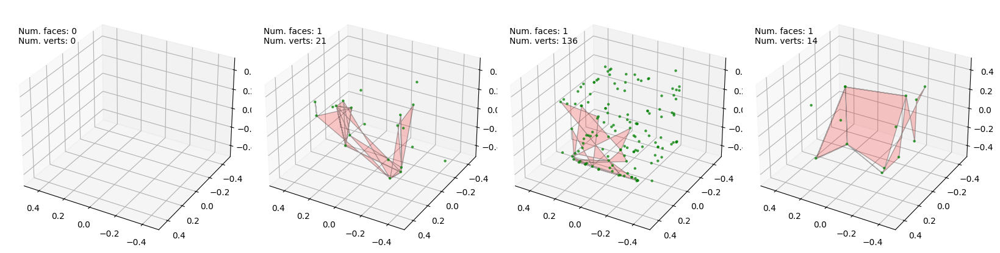

Step 70
Loss (vertices) 878.2318725585938
Loss (faces) 968.11083984375


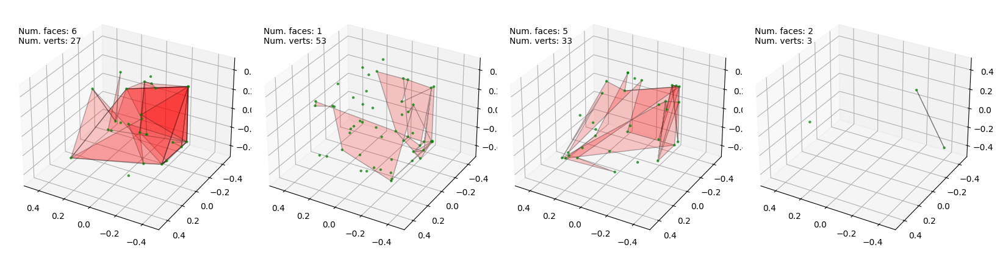

Step 75
Loss (vertices) 790.351318359375
Loss (faces) 852.3192138671875


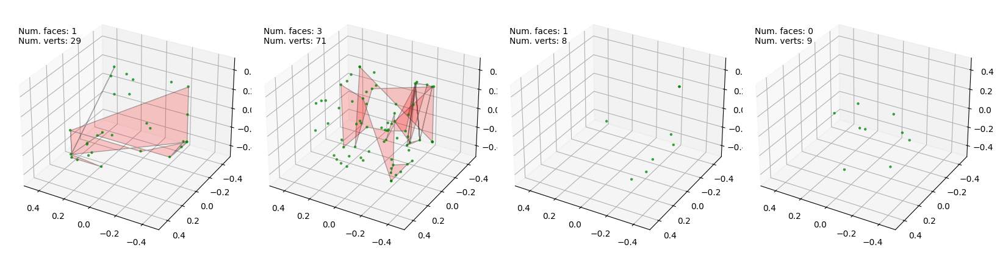

Step 80
Loss (vertices) 692.4188232421875
Loss (faces) 771.9489135742188


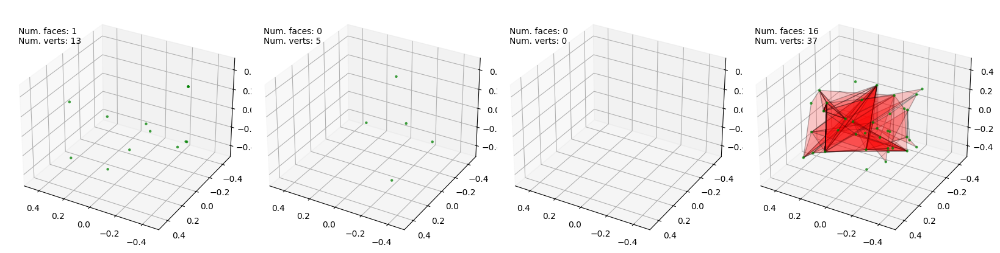

Step 85
Loss (vertices) 597.2715454101562
Loss (faces) 646.4576416015625


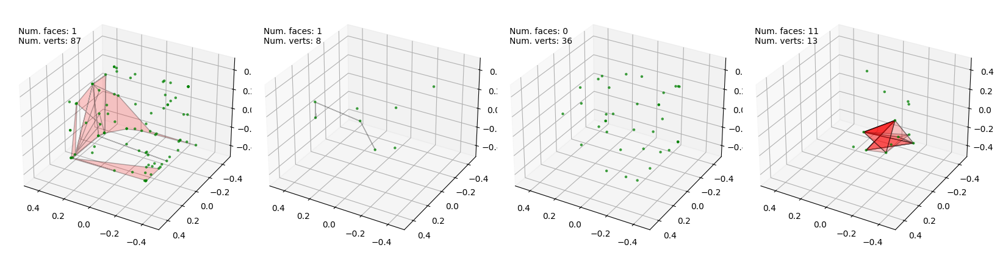

Step 90
Loss (vertices) 511.99871826171875
Loss (faces) 575.1409301757812


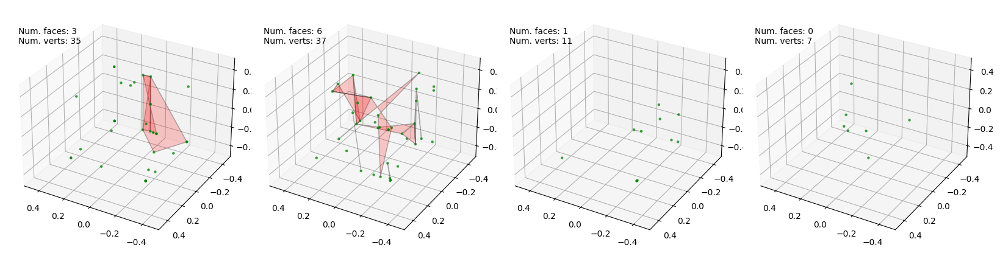

Step 95
Loss (vertices) 432.19927978515625
Loss (faces) 499.01641845703125


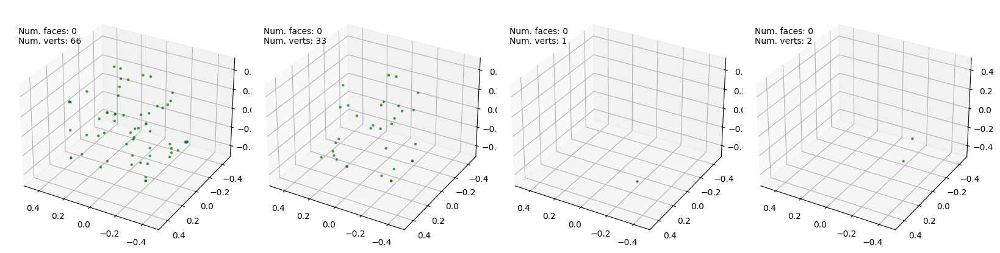

Step 100
Loss (vertices) 360.1821594238281
Loss (faces) 419.11248779296875


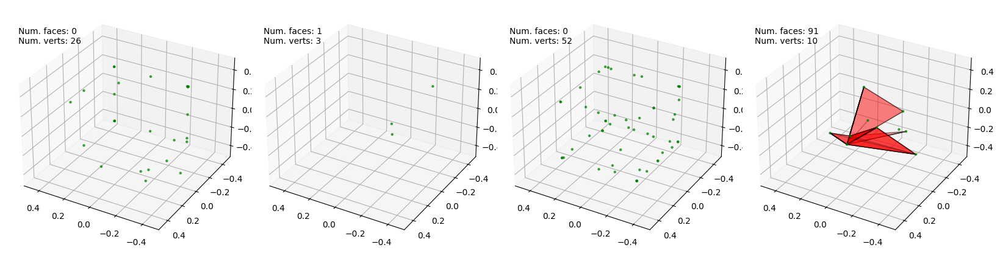

Step 105
Loss (vertices) 298.7648620605469
Loss (faces) 355.3027038574219


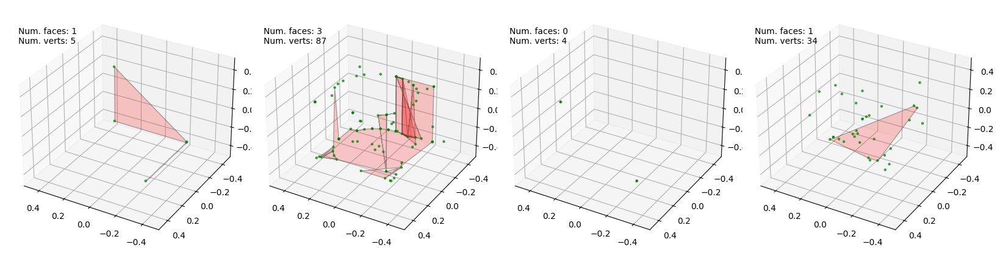

Step 110
Loss (vertices) 249.4676971435547
Loss (faces) 291.45404052734375


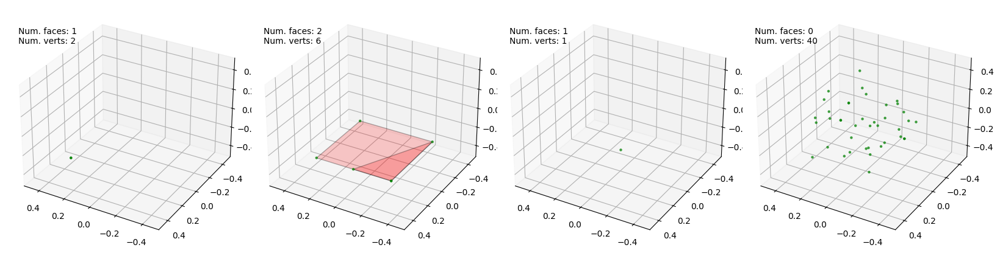

Step 115
Loss (vertices) 209.3987274169922
Loss (faces) 240.08169555664062


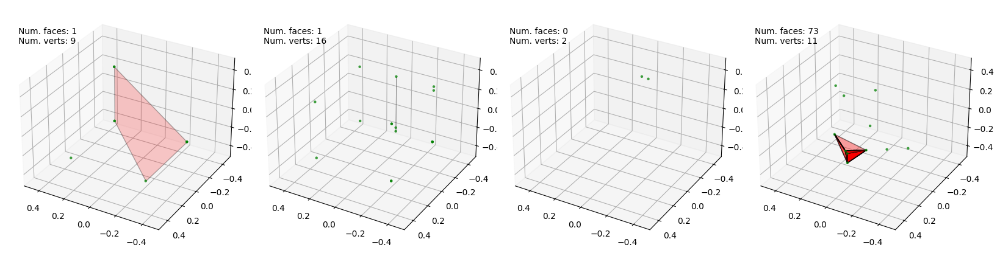

Step 120
Loss (vertices) 178.65200805664062
Loss (faces) 426.016845703125


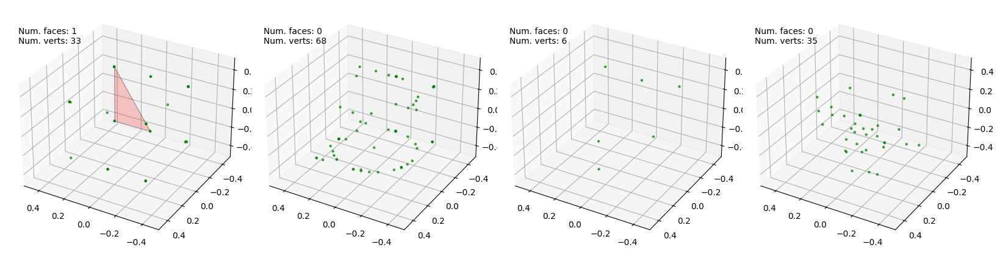

Step 125
Loss (vertices) 153.23324584960938
Loss (faces) 274.60430908203125


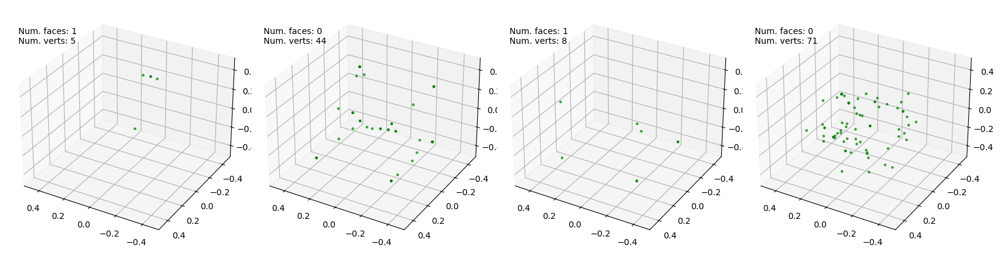

Step 130
Loss (vertices) 131.3634490966797
Loss (faces) 213.92474365234375


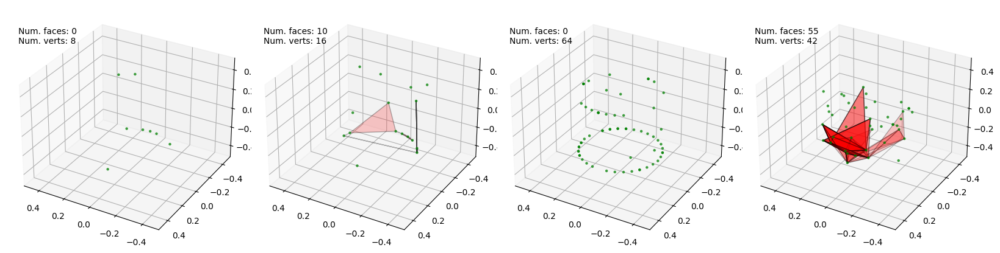

Step 135
Loss (vertices) 109.79439544677734
Loss (faces) 186.9990692138672


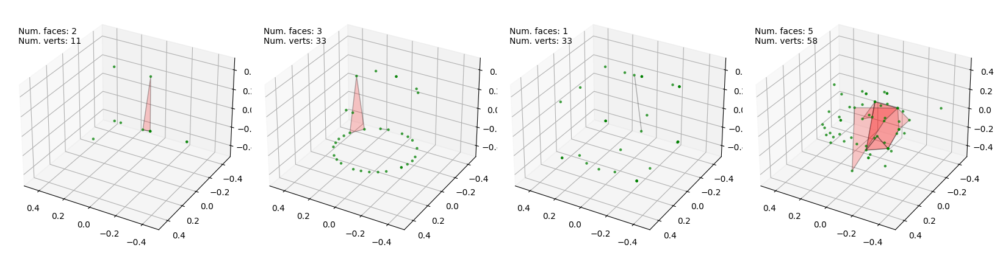

Step 140
Loss (vertices) 89.52308654785156
Loss (faces) 151.7965850830078


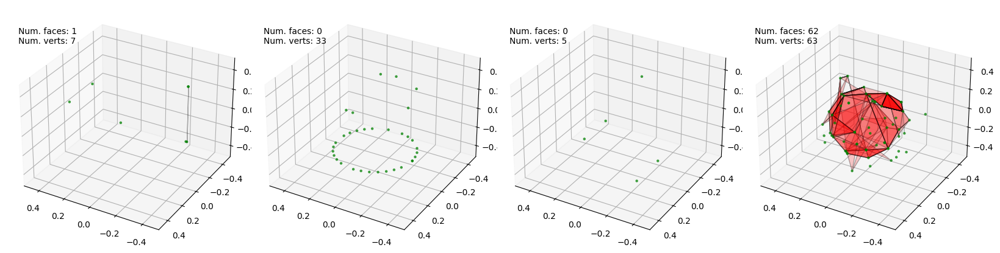

Step 145
Loss (vertices) 69.7873306274414
Loss (faces) 125.71480560302734


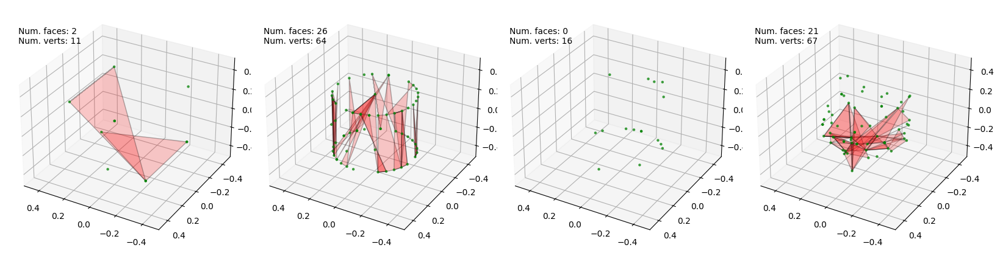

Step 150
Loss (vertices) 55.39460372924805
Loss (faces) 105.4560546875


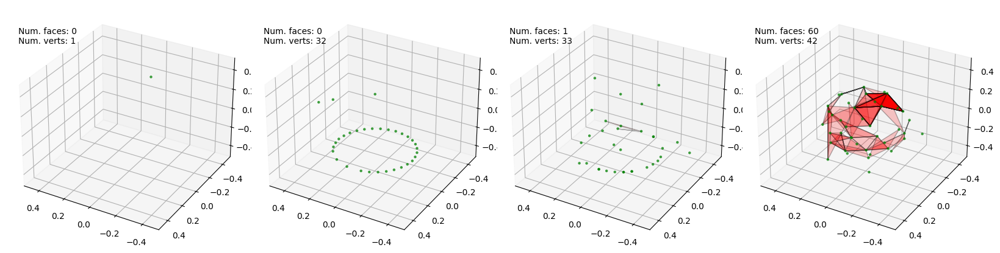

Step 155
Loss (vertices) 43.84821701049805
Loss (faces) 89.32266235351562


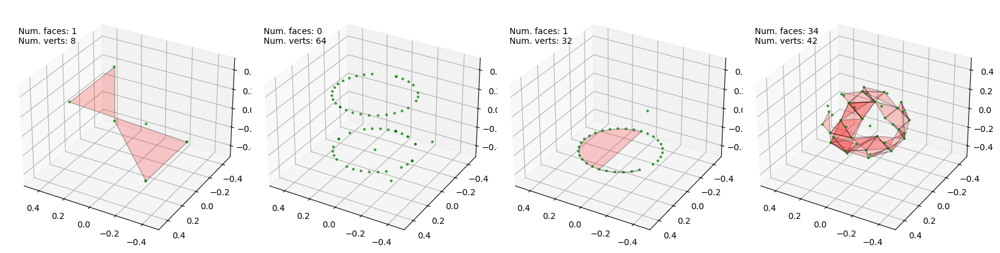

Step 160
Loss (vertices) 34.6792106628418
Loss (faces) 76.46900939941406


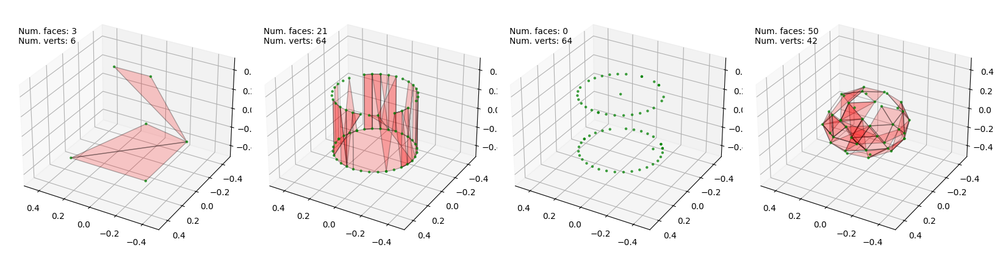

Step 165
Loss (vertices) 27.073869705200195
Loss (faces) 65.56072235107422


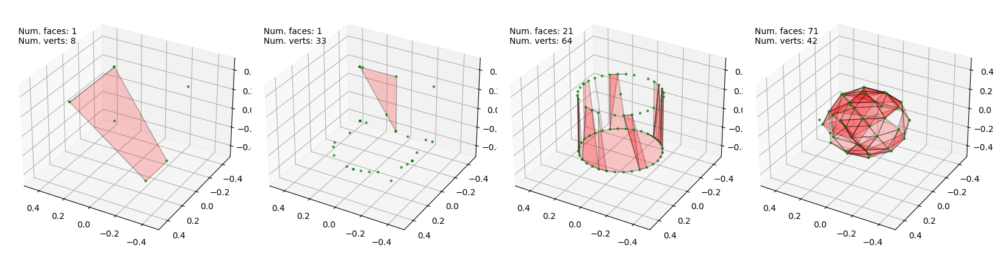

Step 170
Loss (vertices) 21.903785705566406
Loss (faces) 56.471927642822266


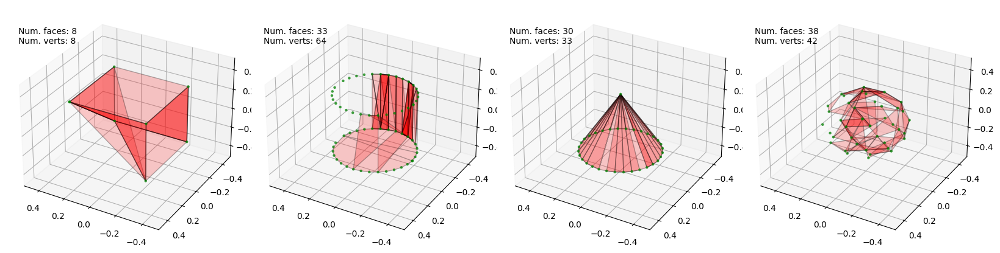

Step 175
Loss (vertices) 18.310014724731445
Loss (faces) 48.82232666015625


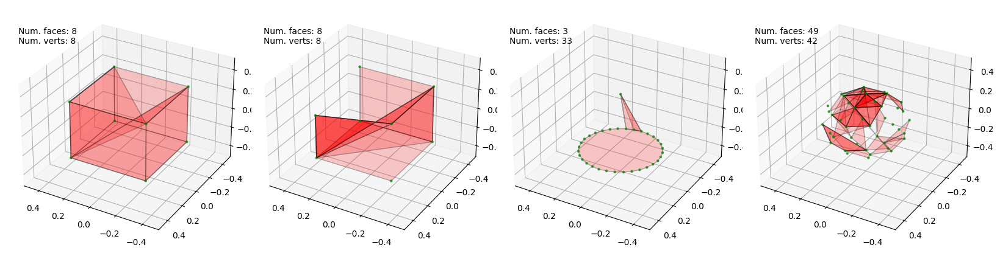

Step 180
Loss (vertices) 15.715338706970215
Loss (faces) 42.23836135864258


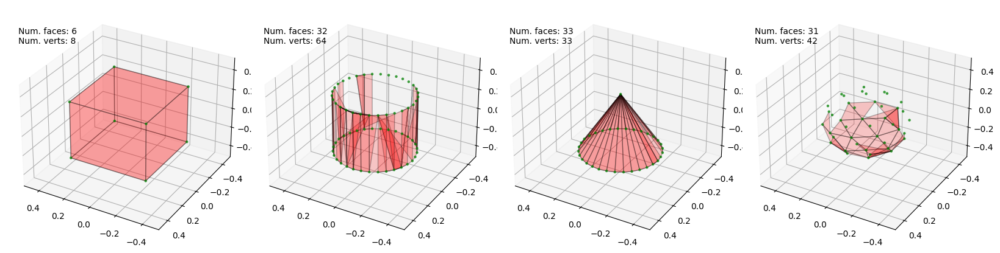

Step 185
Loss (vertices) 13.759358406066895
Loss (faces) 36.68966293334961


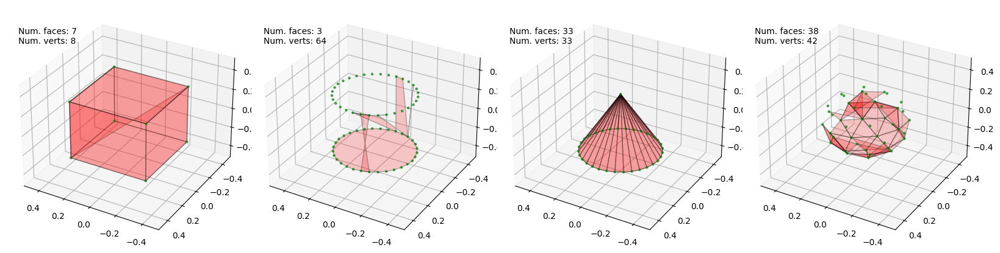

Step 190
Loss (vertices) 12.260546684265137
Loss (faces) 32.01923751831055


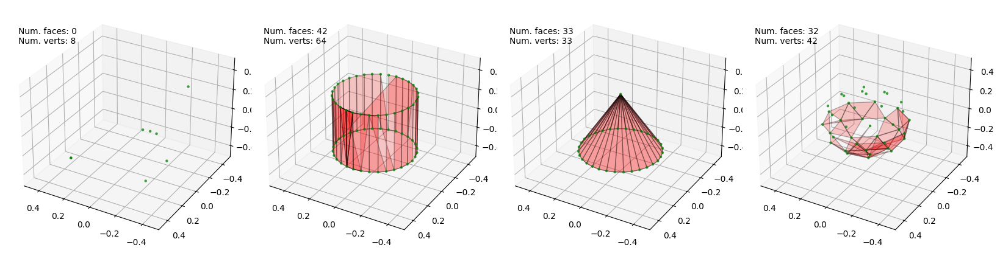

Step 195
Loss (vertices) 11.094529151916504
Loss (faces) 28.04082489013672


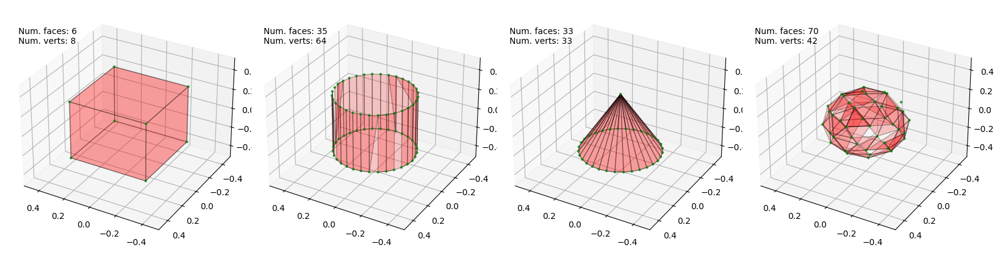

Step 200
Loss (vertices) 10.17297077178955
Loss (faces) 24.629558563232422


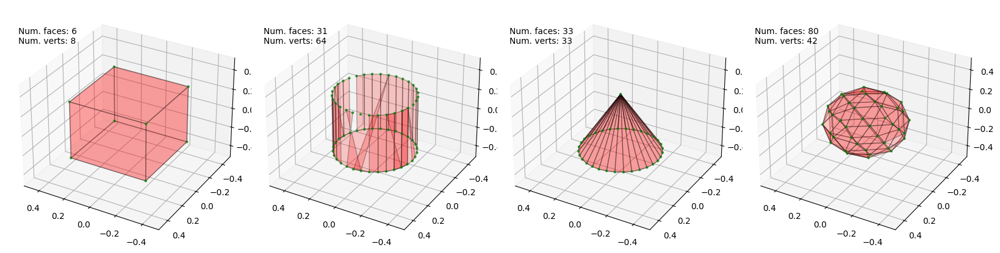

Step 205
Loss (vertices) 9.420369148254395
Loss (faces) 21.733535766601562


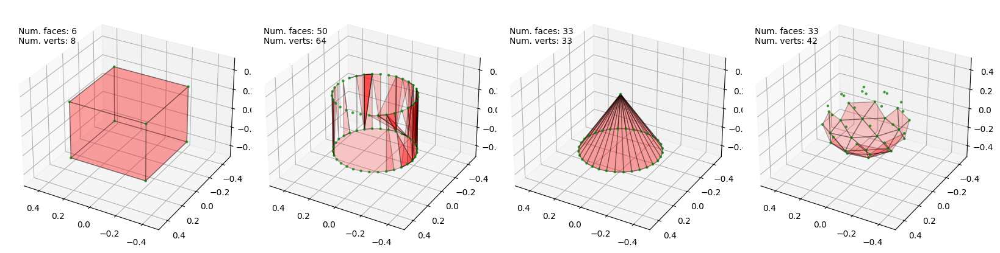

Step 210
Loss (vertices) 8.786296844482422
Loss (faces) 19.314115524291992


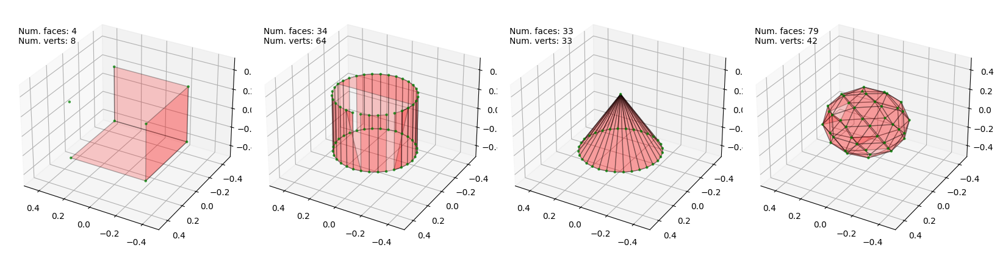

Step 215
Loss (vertices) 8.241607666015625
Loss (faces) 17.301149368286133


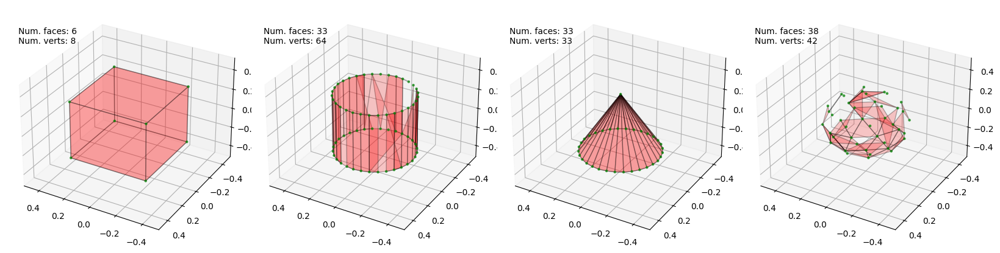

Step 220
Loss (vertices) 7.765866279602051
Loss (faces) 15.610750198364258


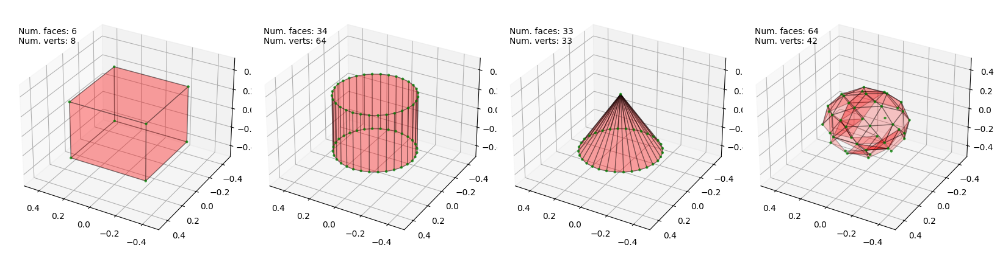

Step 225
Loss (vertices) 7.344481468200684
Loss (faces) 14.177724838256836


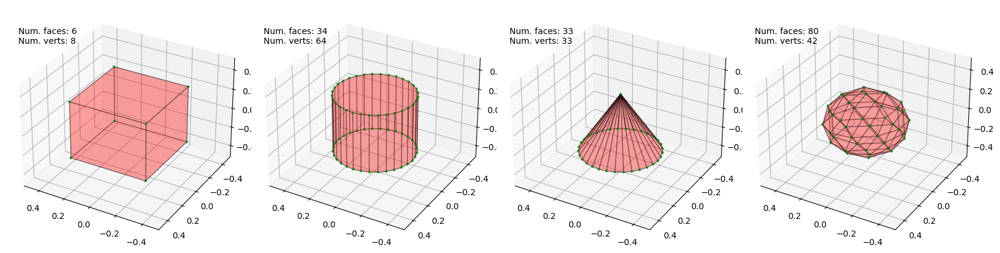

Step 230
Loss (vertices) 6.967634201049805
Loss (faces) 12.951647758483887


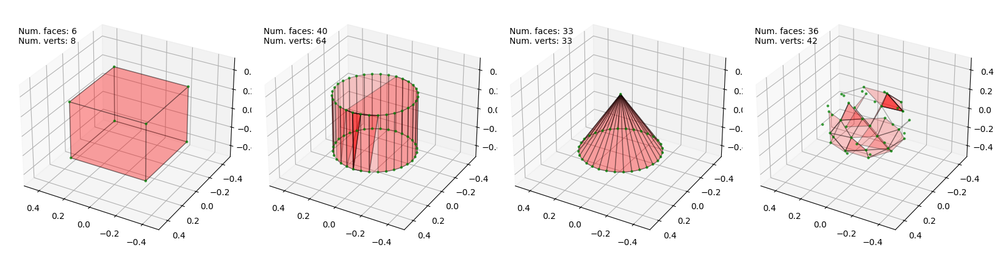

Step 235
Loss (vertices) 6.627744674682617
Loss (faces) 11.893122673034668


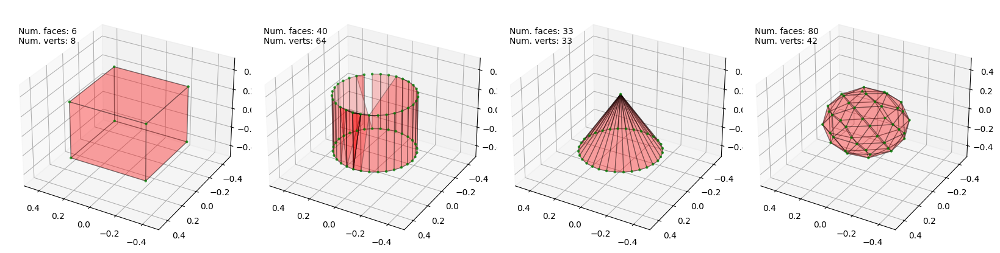

Step 240
Loss (vertices) 6.319065093994141
Loss (faces) 10.972434997558594


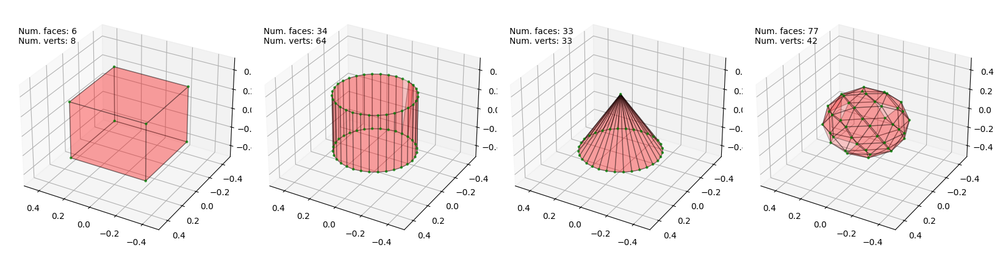

Step 245
Loss (vertices) 6.037009239196777
Loss (faces) 10.166158676147461


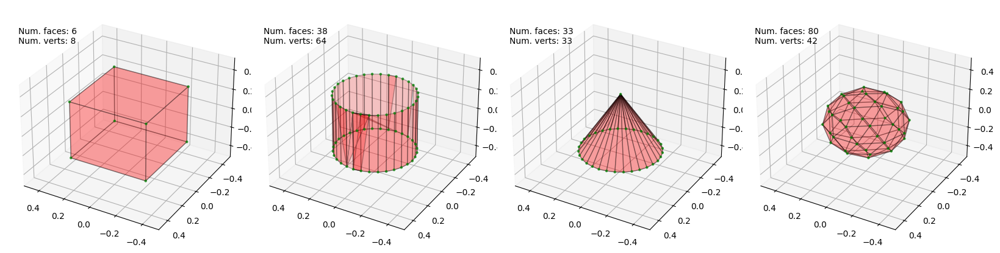

Step 250
Loss (vertices) 5.778006553649902
Loss (faces) 9.454991340637207


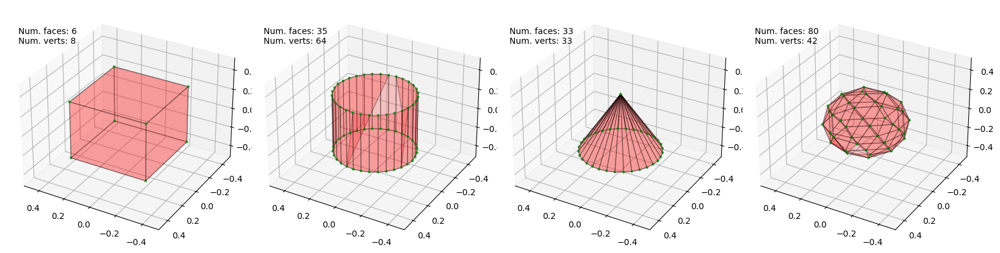

Step 255
Loss (vertices) 5.539143085479736
Loss (faces) 8.82352352142334


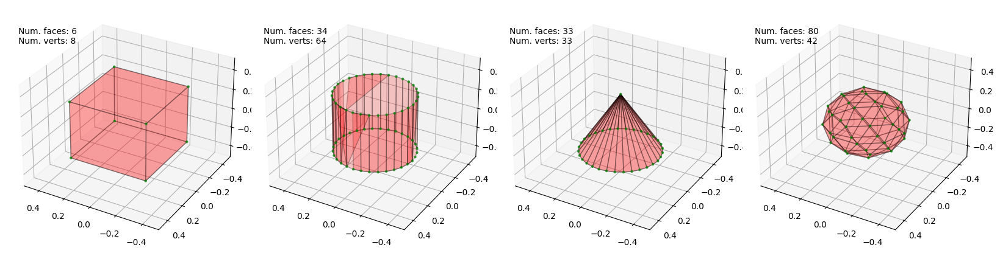

Step 260
Loss (vertices) 5.317974090576172
Loss (faces) 8.259856224060059


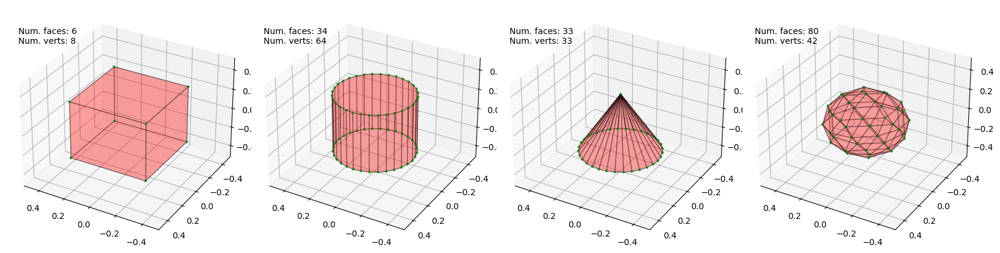

Step 265
Loss (vertices) 5.112508296966553
Loss (faces) 7.754467010498047


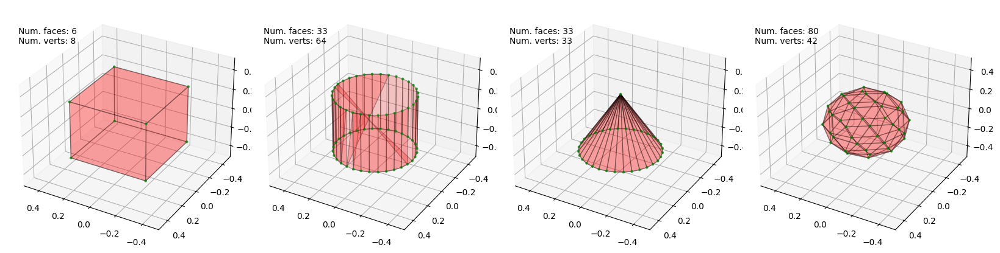

Step 270
Loss (vertices) 4.921046257019043
Loss (faces) 7.299319267272949


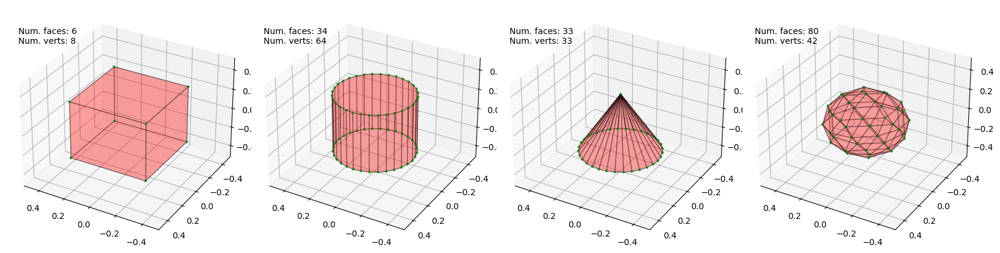

Step 275
Loss (vertices) 4.742181301116943
Loss (faces) 6.887482643127441


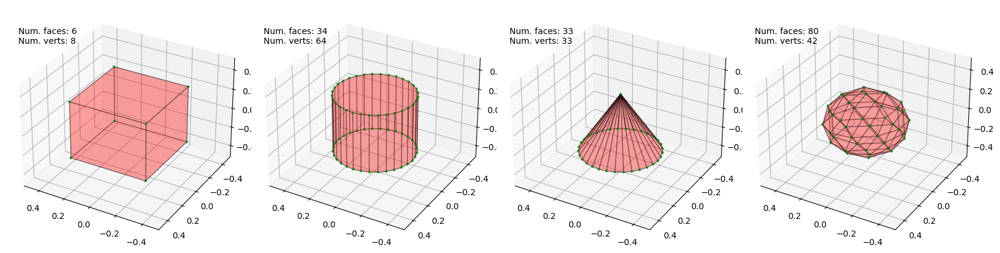

Step 280
Loss (vertices) 4.5746660232543945
Loss (faces) 6.513219833374023


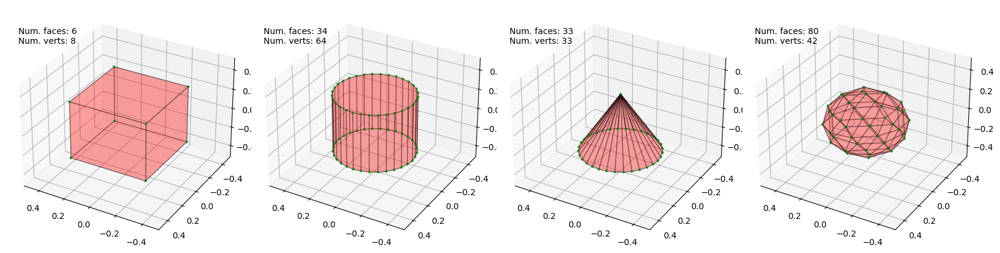

Step 285
Loss (vertices) 4.417444229125977
Loss (faces) 6.171813488006592


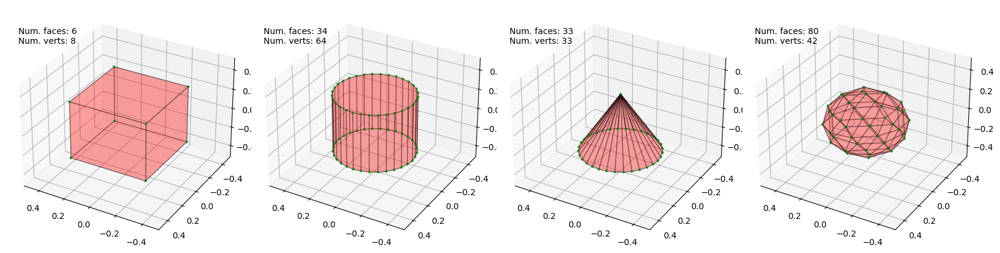

Step 290
Loss (vertices) 4.269589424133301
Loss (faces) 5.859210014343262


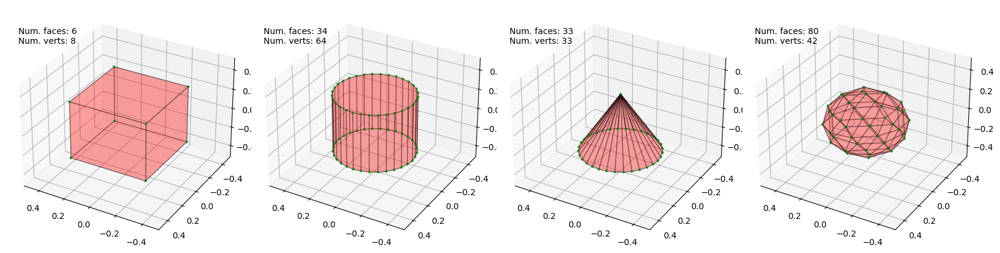

Step 295
Loss (vertices) 4.13029146194458
Loss (faces) 5.572148323059082


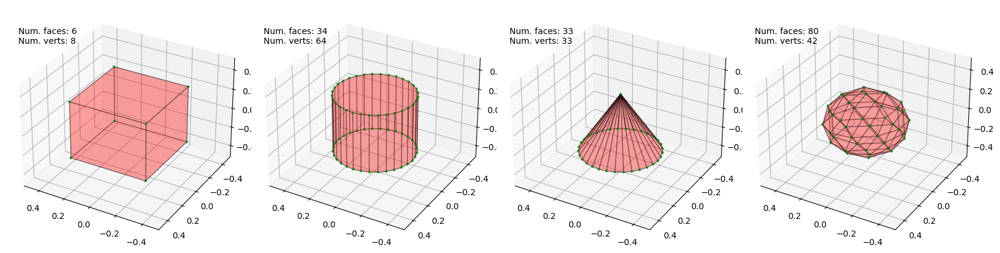

Step 300
Loss (vertices) 3.998793125152588
Loss (faces) 5.307815074920654


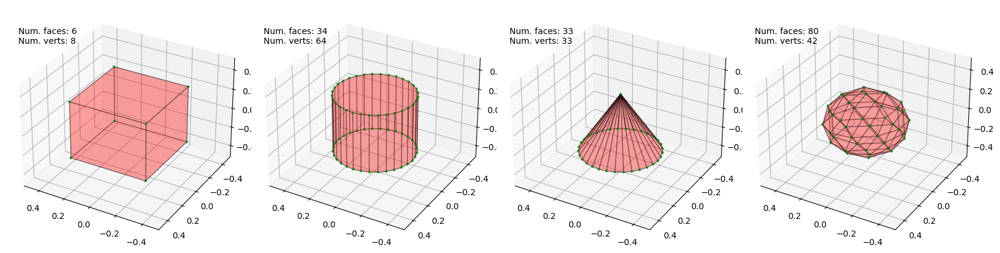

Step 305
Loss (vertices) 3.874490976333618
Loss (faces) 5.063793182373047


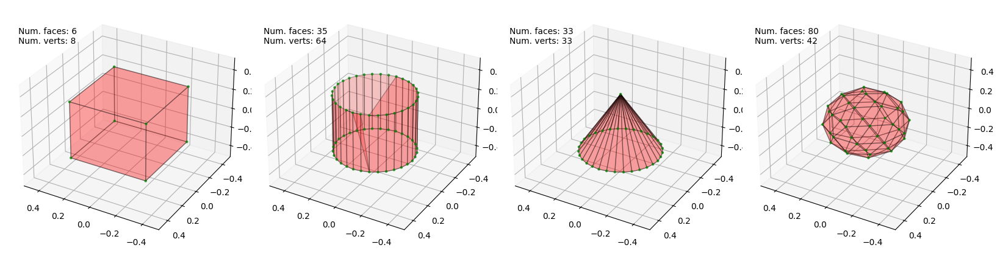

Step 310
Loss (vertices) 3.7567849159240723
Loss (faces) 4.837928771972656


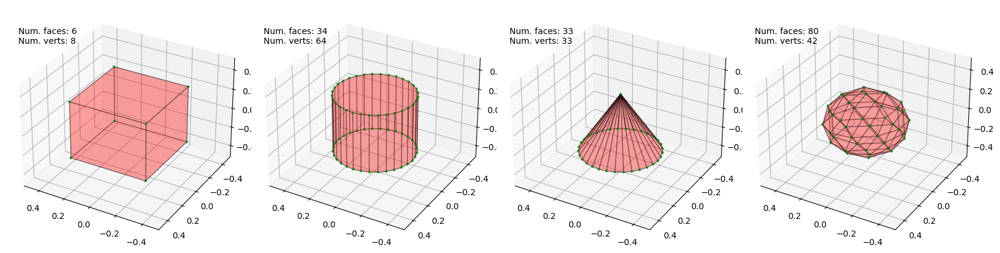

Step 315
Loss (vertices) 3.645188093185425
Loss (faces) 4.6283369064331055


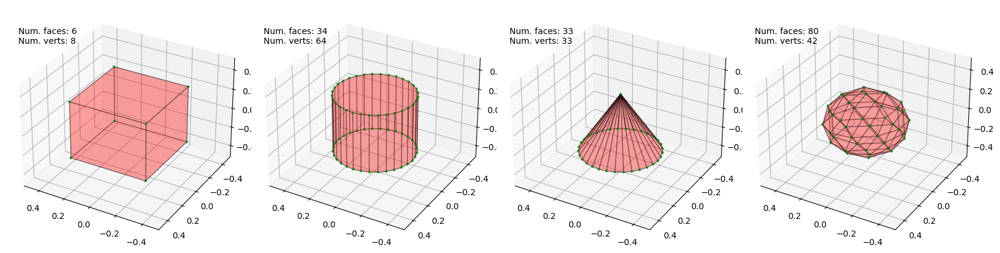

Step 320
Loss (vertices) 3.5392215251922607
Loss (faces) 4.4334211349487305


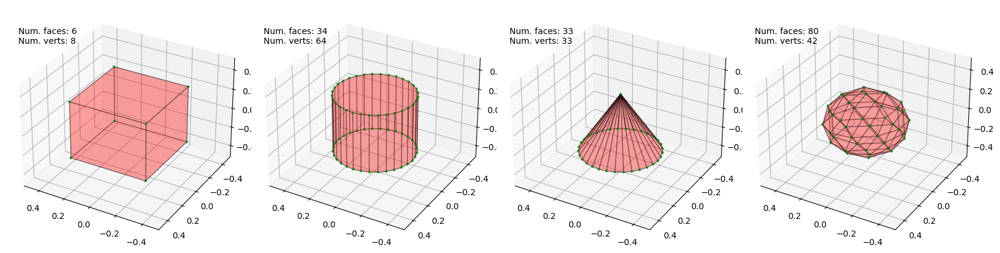

Step 325
Loss (vertices) 3.438488006591797
Loss (faces) 4.251735210418701


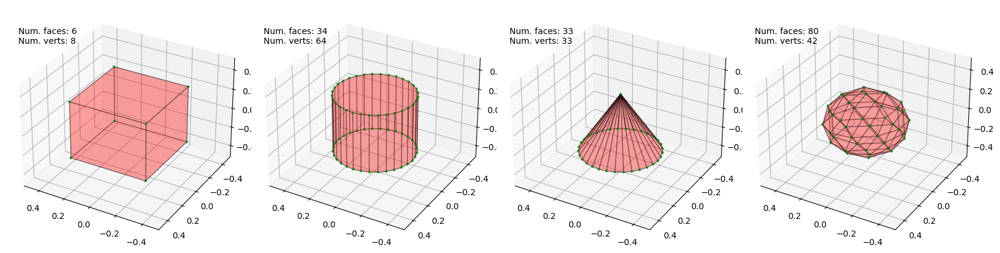

Step 330
Loss (vertices) 3.3426129817962646
Loss (faces) 4.082074165344238


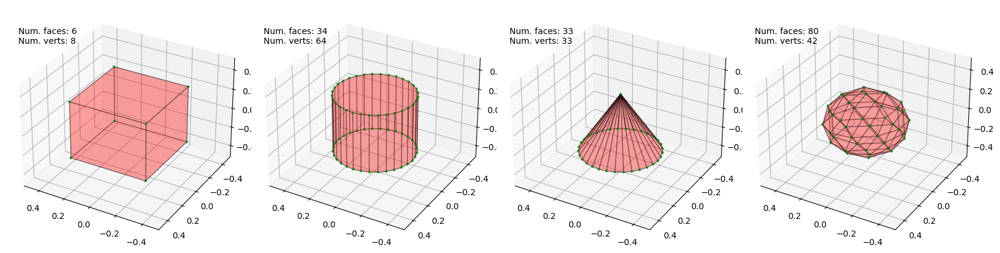

Step 335
Loss (vertices) 3.2512660026550293
Loss (faces) 3.9232935905456543


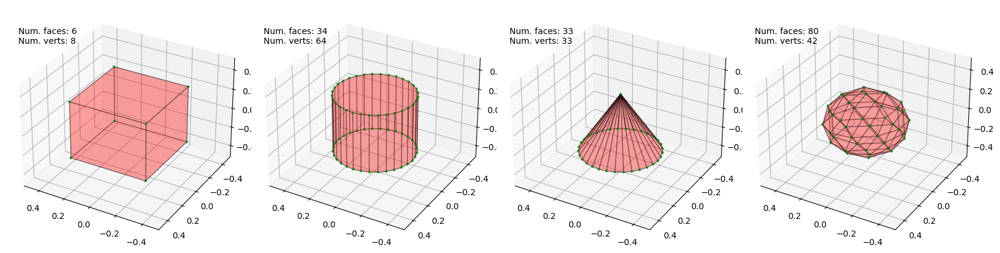

Step 340
Loss (vertices) 3.164130210876465
Loss (faces) 3.774481773376465


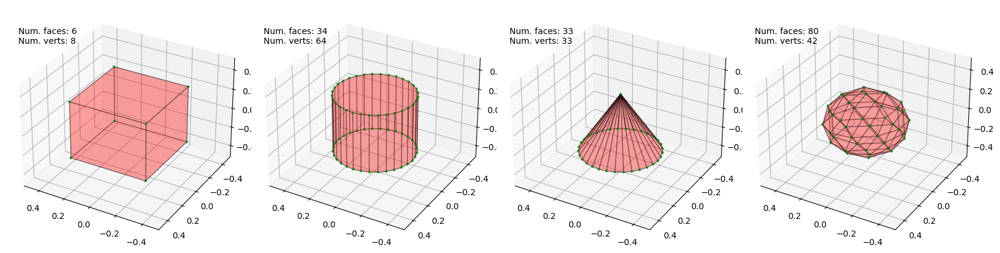

Step 345
Loss (vertices) 3.0809237957000732
Loss (faces) 3.6347663402557373


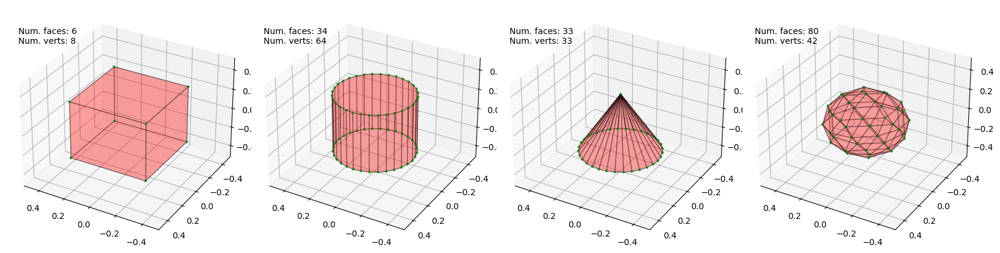

Step 350
Loss (vertices) 3.0013954639434814
Loss (faces) 3.5033669471740723


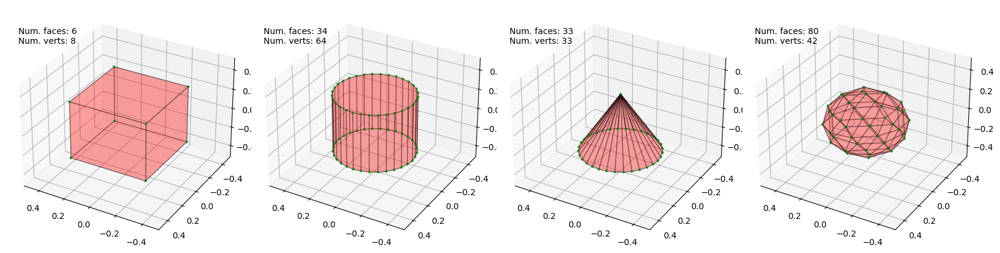

Step 355
Loss (vertices) 2.92531681060791
Loss (faces) 3.3795785903930664


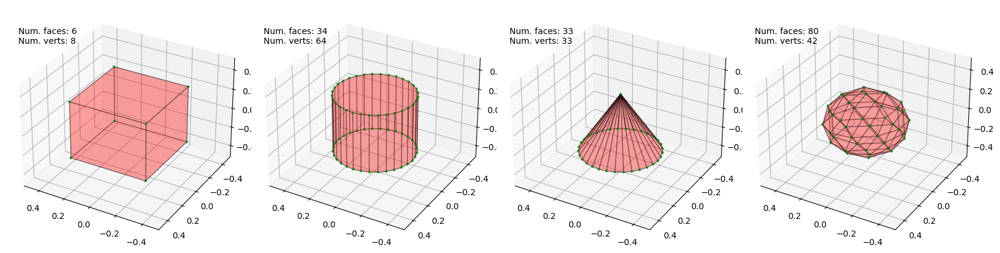

Step 360
Loss (vertices) 2.852461814880371
Loss (faces) 3.2628421783447266


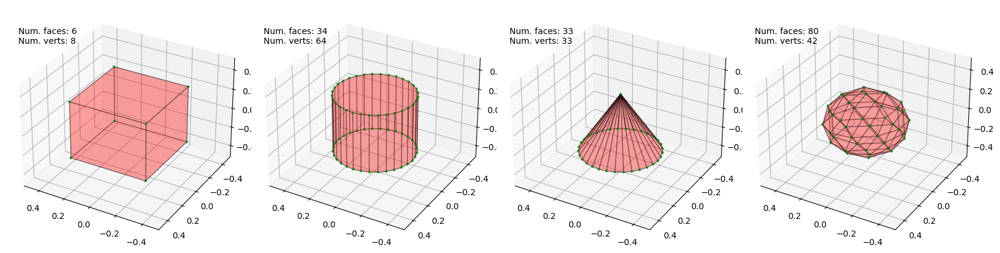

Step 365
Loss (vertices) 2.7826504707336426
Loss (faces) 3.152555227279663


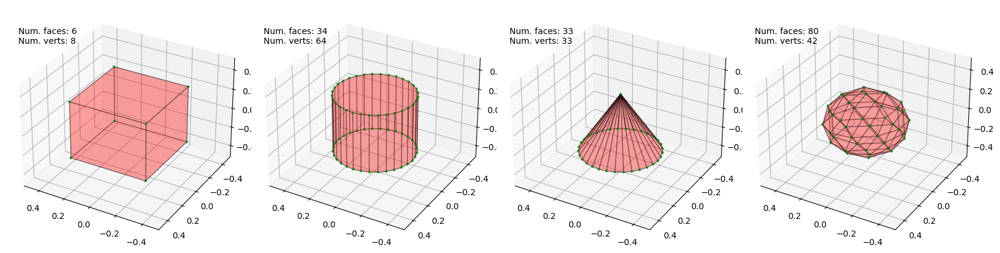

Step 370
Loss (vertices) 2.715693235397339
Loss (faces) 3.048269271850586


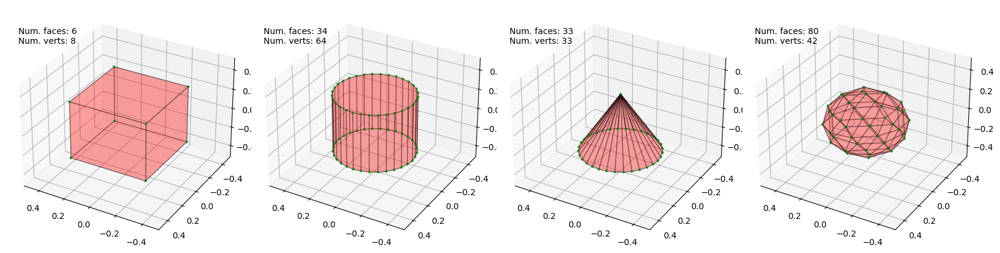

Step 375
Loss (vertices) 2.65142822265625
Loss (faces) 2.9495344161987305


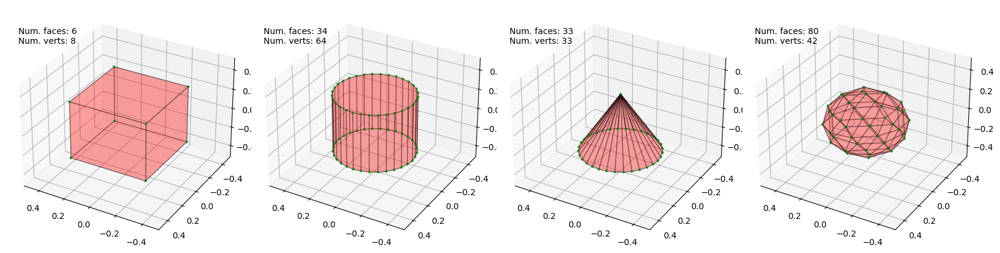

Step 380
Loss (vertices) 2.5896992683410645
Loss (faces) 2.8559842109680176


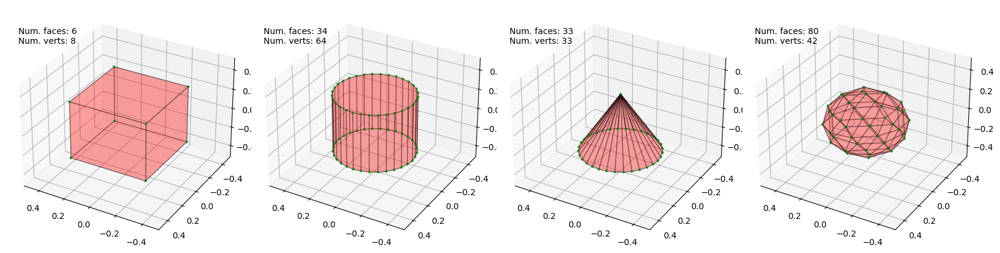

Step 385
Loss (vertices) 2.5303680896759033
Loss (faces) 2.7672266960144043


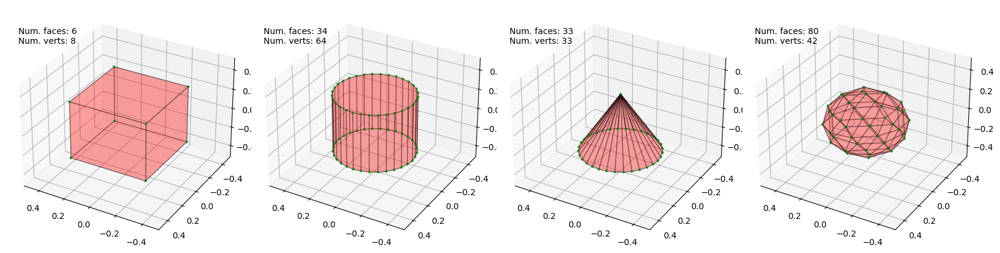

Step 390
Loss (vertices) 2.473299503326416
Loss (faces) 2.6829538345336914


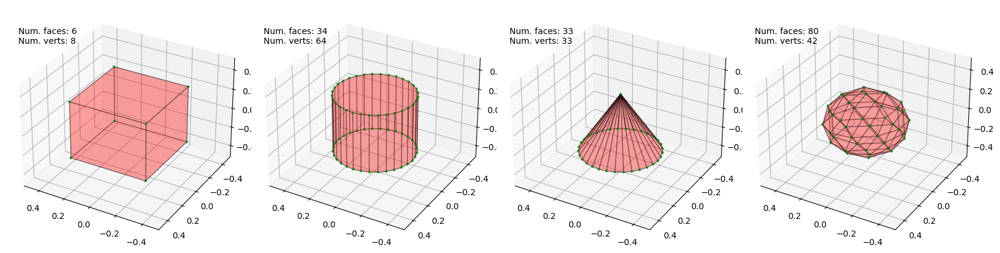

Step 395
Loss (vertices) 2.4183645248413086
Loss (faces) 2.6028501987457275


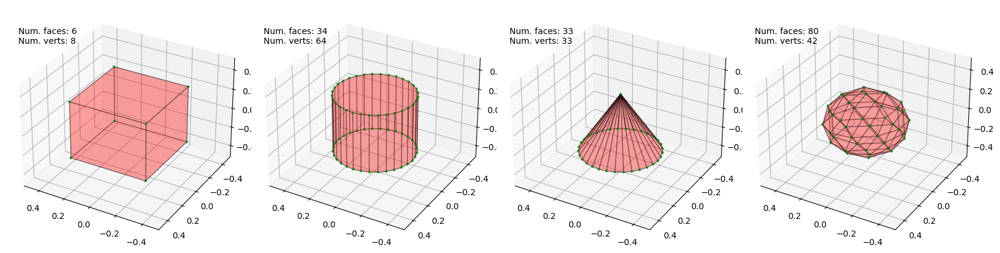

Step 400
Loss (vertices) 2.365464210510254
Loss (faces) 2.5266408920288086


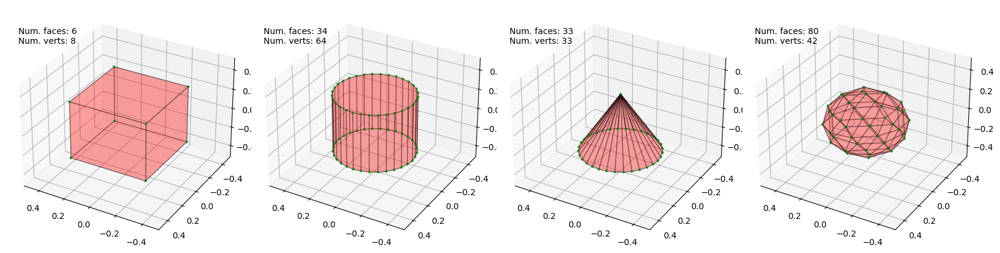

Step 405
Loss (vertices) 2.31447696685791
Loss (faces) 2.454066276550293


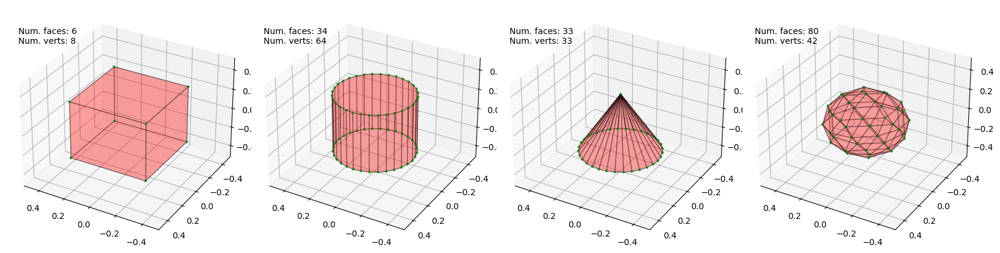

Step 410
Loss (vertices) 2.2653186321258545
Loss (faces) 2.384866237640381


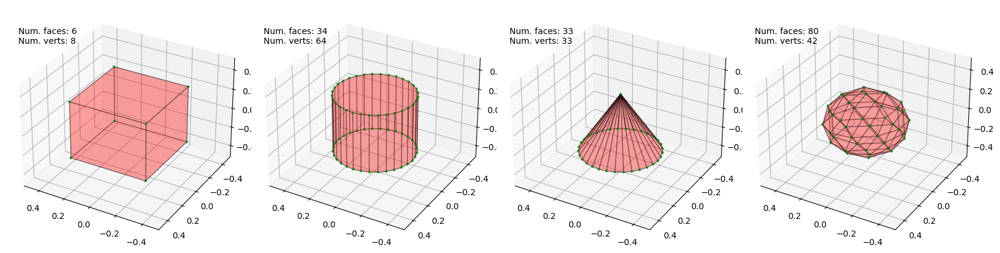

Step 415
Loss (vertices) 2.217881202697754
Loss (faces) 2.318837881088257


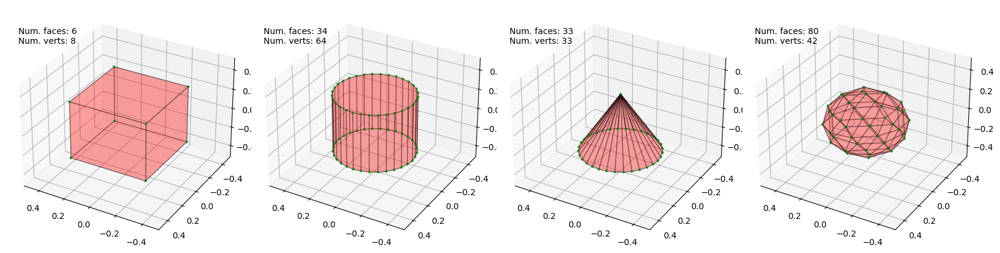

Step 420
Loss (vertices) 2.172086000442505
Loss (faces) 2.2557854652404785


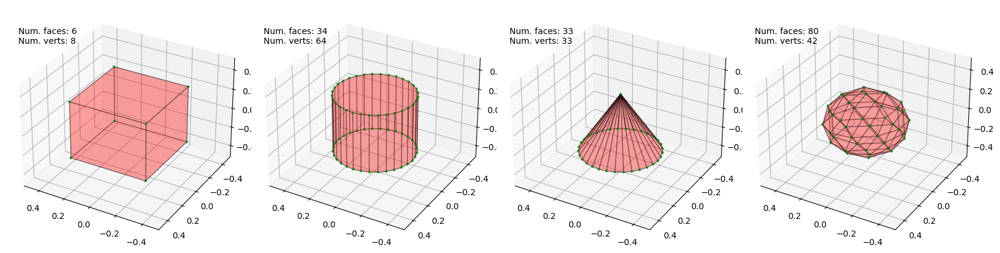

Step 425
Loss (vertices) 2.127856731414795
Loss (faces) 2.195512056350708


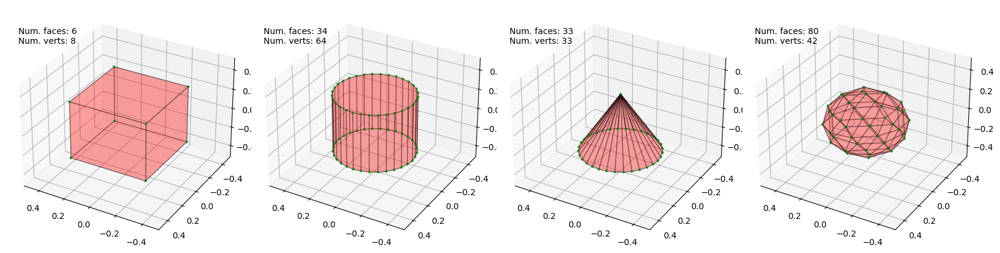

Step 430
Loss (vertices) 2.0851218700408936
Loss (faces) 2.137840509414673


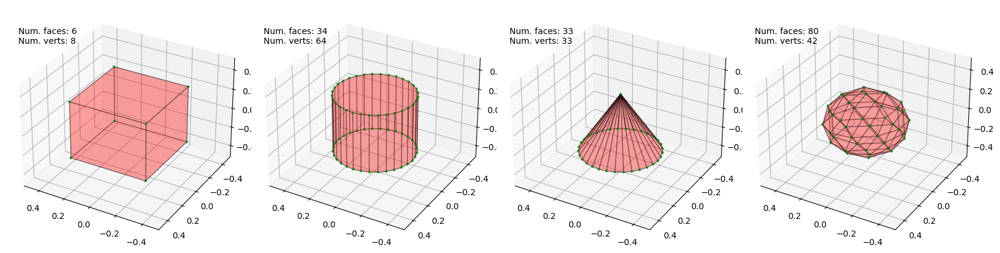

Step 435
Loss (vertices) 2.0437934398651123
Loss (faces) 2.08264422416687


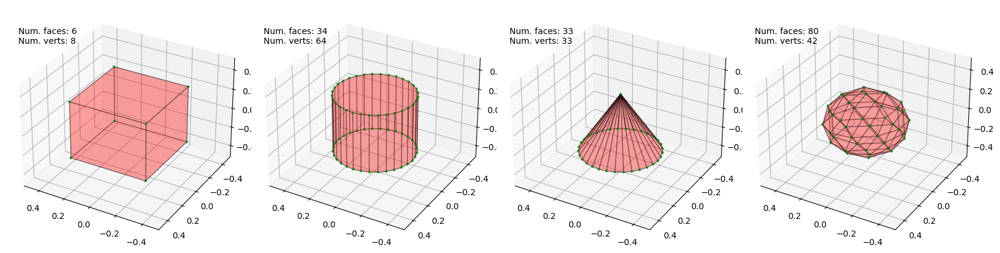

Step 440
Loss (vertices) 2.0038092136383057
Loss (faces) 2.0297529697418213


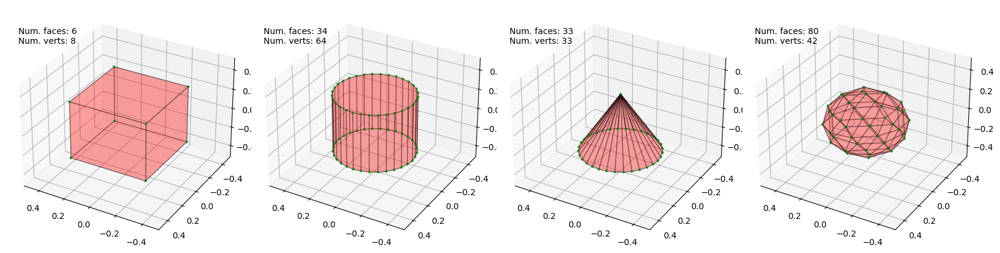

Step 445
Loss (vertices) 1.9651209115982056
Loss (faces) 1.979024052619934


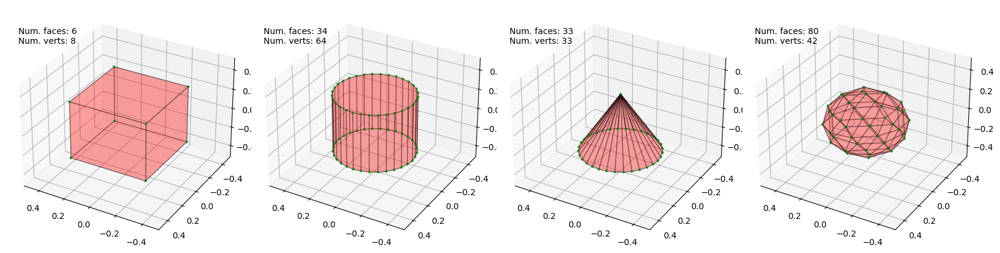

Step 450
Loss (vertices) 1.9276618957519531
Loss (faces) 1.9303438663482666


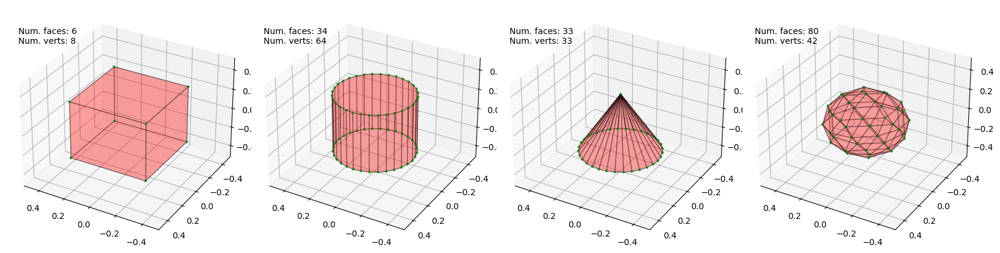

Step 455
Loss (vertices) 1.8913695812225342
Loss (faces) 1.8836002349853516


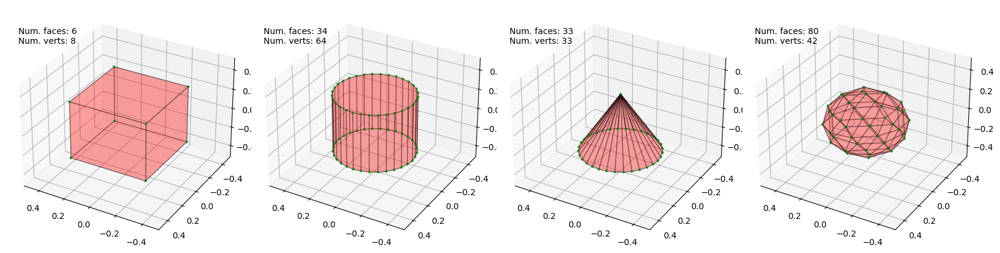

Step 460
Loss (vertices) 1.8562002182006836
Loss (faces) 1.8386824131011963


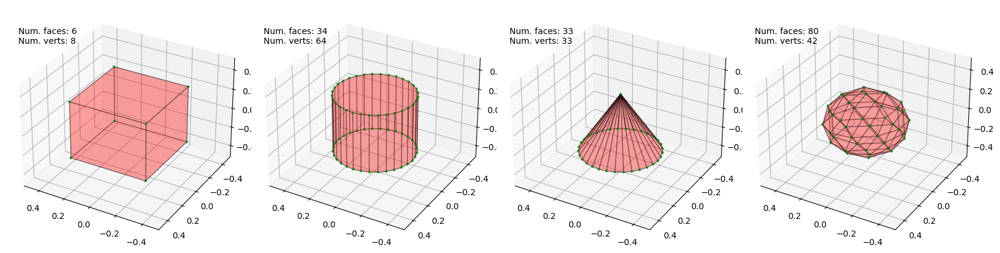

Step 465
Loss (vertices) 1.8221138715744019
Loss (faces) 1.7954840660095215


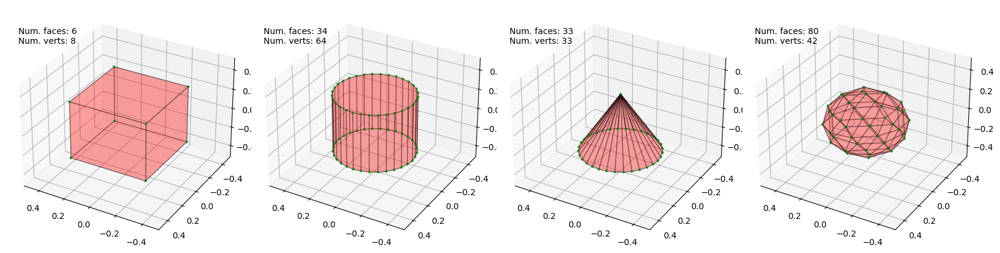

Step 470
Loss (vertices) 1.789042353630066
Loss (faces) 1.7539124488830566


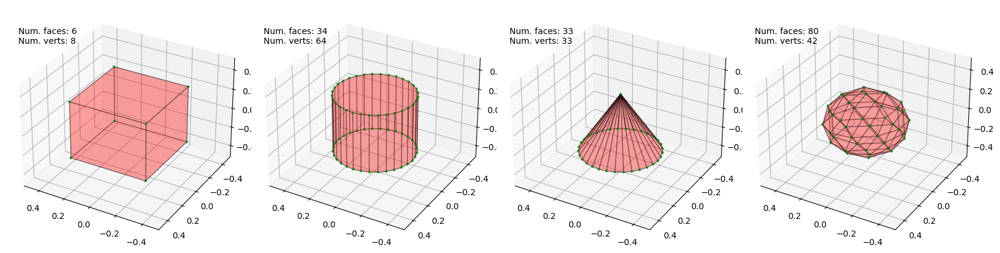

Step 475
Loss (vertices) 1.7569595575332642
Loss (faces) 1.7138996124267578


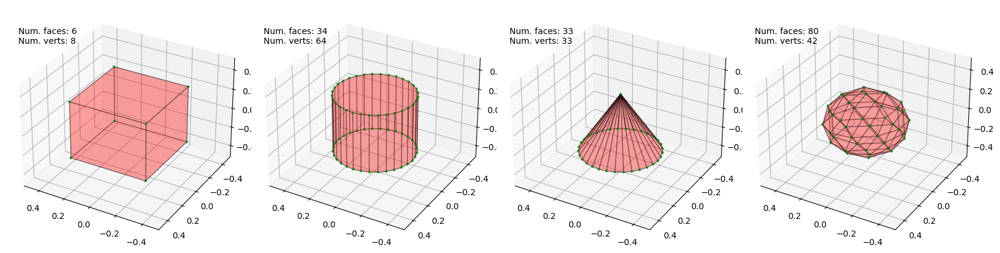

Step 480
Loss (vertices) 1.7258148193359375
Loss (faces) 1.675342082977295


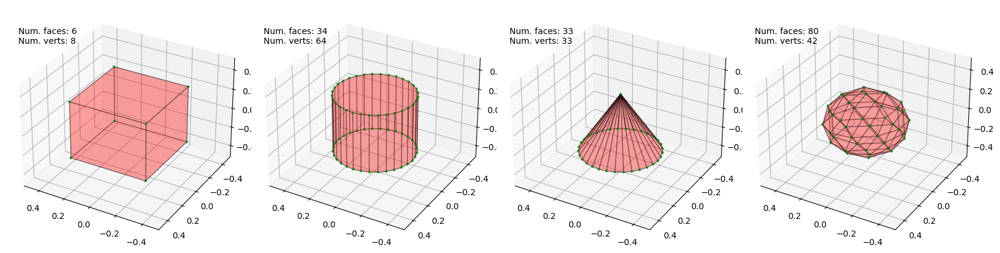

Step 485
Loss (vertices) 1.695574164390564
Loss (faces) 1.6381961107254028


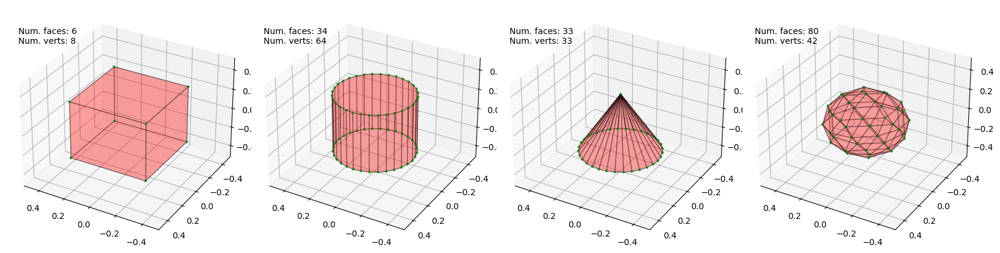

Step 490
Loss (vertices) 1.6661972999572754
Loss (faces) 1.60236656665802


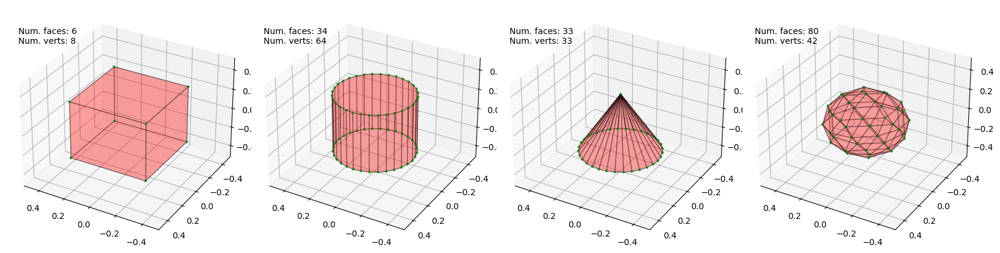

Step 495
Loss (vertices) 1.6376506090164185
Loss (faces) 1.5678048133850098


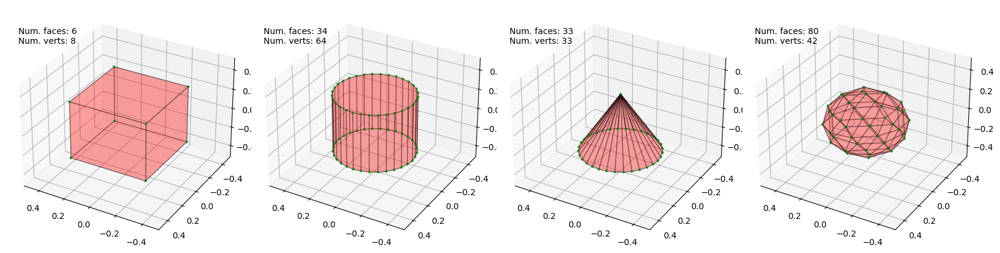

In [9]:
# Optimization settings
learning_rate = 5e-4
training_steps = 500
check_step = 5

# Create an optimizer an minimize the summed log probability of the mesh 
# sequences
optimizer = tf.train.AdamOptimizer(learning_rate)
vertex_model_optim_op = optimizer.minimize(vertex_model_loss)
face_model_optim_op = optimizer.minimize(face_model_loss)

# Training loop
with tf.Session() as sess:
  sess.run(tf.global_variables_initializer())
  for n in range(training_steps):
    if n % check_step == 0:
      v_loss, f_loss = sess.run((vertex_model_loss, face_model_loss))
      print('Step {}'.format(n))
      print('Loss (vertices) {}'.format(v_loss))
      print('Loss (faces) {}'.format(f_loss))
      v_samples_np, f_samples_np, b_np = sess.run(
        (vertex_samples, face_samples, vertex_model_batch))
      mesh_list = []
      for n in range(4):
        mesh_list.append(
            {
                'vertices': v_samples_np['vertices'][n][:v_samples_np['num_vertices'][n]],
                'faces': data_utils.unflatten_faces(
                    f_samples_np['faces'][n][:f_samples_np['num_face_indices'][n]])
            }
        )
      data_utils.plot_meshes(mesh_list, ax_lims=0.5)
    sess.run((vertex_model_optim_op, face_model_optim_op))